In [1]:
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import sys
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage.utils import gene_plot, Read10X, ReadOldST
from stimage.model import negative_binomial_layer, negative_binomial_loss, CNN_NB_model

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input as preprocess_resnet
import numpy as np
from tensorflow.keras.models import Model
class DataGenerator(keras.utils.Sequence):
    'Generates data for Keras'

    def __init__(self, adata, batch_size=32, dim=(299, 299), n_channels=3,
                 genes=None, shuffle=True, is_train=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.adata = adata
        self.n_channels = n_channels
        self.genes = genes
        self.num_genes = len(genes)
        self.shuffle = shuffle
        self.is_train = is_train
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(self.adata.n_obs / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index * self.batch_size:(index + 1) * self.batch_size]

        # Find list of IDs
        obs_temp = [self.adata.obs_names[k] for k in indexes]

        # Generate data
        X_img, y = self.__data_generation(obs_temp)
        if self.is_train:
            return X_img, y
        else:
            return X_img

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(self.adata.n_obs)
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, obs_temp):
        'Generates data containing batch_size samples'  # X : (n_samples, *dim, n_channels)
        # Initialization
        X_img = np.empty((self.batch_size, *self.dim, self.n_channels))
        y = np.empty((self.batch_size, self.num_genes), dtype="float")

        # Generate data
        for i, obs in enumerate(obs_temp):
            # Store img
            X_img[i,] = self._load_img(obs)

            # Store class
            y[i,] = self._load_label(obs)

        return X_img, y

    def _load_img(self, obs):
        img_path = self.adata.obs.loc[obs, 'tile_path']
        X_img = image.load_img(img_path, target_size=self.dim)
        X_img = image.img_to_array(X_img)
        X_img = np.expand_dims(X_img, axis=0)
#         n_rotate = np.random.randint(0, 4)
#         X_img = np.rot90(X_img, k=n_rotate, axes=(1, 2))
        X_img = preprocess_resnet(X_img)
        return X_img

    def _load_label(self, obs):
        return self.adata.to_df().loc[obs, self.genes]

    def get_classes(self):
        return self.adata.to_df().loc[:,self.genes]

In [3]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = BASE_PATH / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

In [4]:
SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [5]:
SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
gene_list=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1"]
gene = gene_list[2]

In [7]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
#     st.pp.filter_genes(adata,min_cells=1)
#     st.pp.normalize_total(adata)
#     st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    st.pp.tiling(adata, TILE_PATH_, crop_size=299)
#     st.pp.extract_feature(adata)

Tiling image: 100%|██████████ [ time left: 00:00 ]
Tiling image: 100%|██████████ [ time left: 00:00 ]


In [21]:
training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.index.isin(training_index)
valid_dataset = Sample1[~valid_index,].copy()

test_dataset = Sample2.copy()

In [33]:
train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=training_dataset, 
                          genes=[gene],
                          batch_size=128), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([128,299,299,3], [128,1])
)
train_gen_ = train_gen.cache().prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=valid_dataset, 
                          genes=[gene],
                          batch_size=128), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([128,299,299,3], [128,1])
)
valid_gen_ = valid_gen.cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=test_dataset, 
                          genes=[gene],
                          batch_size=1,
                          shuffle=False), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([1,299,299,3], [1,1])
)

In [34]:
for images, labels in test_gen.take(1):
    print('images.shape: ', images.shape)
    print('labels.shape: ', labels.shape)

images.shape:  (1, 299, 299, 3)
labels.shape:  (1, 1)


In [23]:
# train_gen = DataGenerator(adata=training_dataset, 
#                           genes=gene,
#                           batch_size=128)
# valid_gen = DataGenerator(adata=valid_dataset, 
#                           genes=gene,
#                           batch_size=128)
# test_gen = DataGenerator(adata=test_dataset, 
#                          genes=gene,
#                          batch_size=1,
#                          shuffle=False, 
#                          is_train=False)

In [10]:
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, concatenate, Dropout, Lambda

def CNN_NB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
    stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
    for i in range(resnet_base.layers.index(stage_5_start)):
        resnet_base.layers[i].trainable = False

    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
    cnn = Dropout(0.5)(cnn)
    cnn = Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l1(0.1),
                activity_regularizer=keras.regularizers.l2(0.1))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    outputs = Dense(2)(cnn)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)
    model = Model(inputs=tile_input, outputs=distribution_outputs)

    # optimizer = tf.keras.optimizers.RMSprop(0.0001)
    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss=negative_binomial_loss,
                  optimizer=optimizer,
                  metrics=[negative_binomial_loss])    
    return model



In [11]:
model = CNN_NB((299, 299, 3))

In [32]:
train_history = model.fit(train_gen_,
                          epochs=100,
                          validation_data=valid_gen_,
                          )

Epoch 1/100
20/20 [==============================] - 337s 17s/step - loss: 79.2860 - negative_binomial_loss: 1.2506 - val_loss: 39.6329 - val_negative_binomial_loss: 1.3251
Epoch 2/100
20/20 [==============================] - 7s 377ms/step - loss: 27.9067 - negative_binomial_loss: 1.2098 - val_loss: 19.2720 - val_negative_binomial_loss: 1.2183
Epoch 3/100
20/20 [==============================] - 7s 374ms/step - loss: 16.7365 - negative_binomial_loss: 1.1969 - val_loss: 15.0772 - val_negative_binomial_loss: 1.1682
Epoch 4/100
20/20 [==============================] - 7s 377ms/step - loss: 14.5872 - negative_binomial_loss: 1.1718 - val_loss: 14.0122 - val_negative_binomial_loss: 1.1215
Epoch 5/100
20/20 [==============================] - 7s 376ms/step - loss: 14.0556 - negative_binomial_loss: 1.1402 - val_loss: 13.9884 - val_negative_binomial_loss: 1.0881
Epoch 6/100
20/20 [==============================] - 7s 378ms/step - loss: 13.9353 - negative_binomial_loss: 1.1357 - val_loss: 13.9269

20/20 [==============================] - 7s 377ms/step - loss: 12.7461 - negative_binomial_loss: 0.7880 - val_loss: 13.0621 - val_negative_binomial_loss: 1.0796
Epoch 49/100
20/20 [==============================] - 7s 376ms/step - loss: 12.7622 - negative_binomial_loss: 0.7825 - val_loss: 13.0148 - val_negative_binomial_loss: 1.0719
Epoch 50/100
20/20 [==============================] - 7s 376ms/step - loss: 12.7713 - negative_binomial_loss: 0.7925 - val_loss: 13.1533 - val_negative_binomial_loss: 1.1079
Epoch 51/100
20/20 [==============================] - 7s 376ms/step - loss: 12.7620 - negative_binomial_loss: 0.7778 - val_loss: 13.0698 - val_negative_binomial_loss: 1.1011
Epoch 52/100
20/20 [==============================] - 7s 376ms/step - loss: 12.7236 - negative_binomial_loss: 0.7683 - val_loss: 12.9550 - val_negative_binomial_loss: 1.0766
Epoch 53/100
20/20 [==============================] - 7s 376ms/step - loss: 12.7552 - negative_binomial_loss: 0.7781 - val_loss: 13.0856 - val_

20/20 [==============================] - 7s 376ms/step - loss: 12.6657 - negative_binomial_loss: 0.6693 - val_loss: 13.0801 - val_negative_binomial_loss: 1.1317
Epoch 96/100
20/20 [==============================] - 7s 376ms/step - loss: 12.5619 - negative_binomial_loss: 0.6534 - val_loss: 13.1314 - val_negative_binomial_loss: 1.2218
Epoch 97/100
20/20 [==============================] - 7s 376ms/step - loss: 12.5988 - negative_binomial_loss: 0.6653 - val_loss: 13.0590 - val_negative_binomial_loss: 1.1408
Epoch 98/100
20/20 [==============================] - 7s 376ms/step - loss: 12.5508 - negative_binomial_loss: 0.6463 - val_loss: 13.2747 - val_negative_binomial_loss: 1.4027
Epoch 99/100
20/20 [==============================] - 7s 375ms/step - loss: 12.5399 - negative_binomial_loss: 0.6418 - val_loss: 13.1976 - val_negative_binomial_loss: 1.2528
Epoch 100/100
20/20 [==============================] - 7s 375ms/step - loss: 12.5484 - negative_binomial_loss: 0.6498 - val_loss: 13.1279 - val

In [36]:
model.save("./cnn_nb_100epoch_19020201.h5")

In [12]:
model.load_weights("./cnn_nb_100epoch_19020201.h5")

In [35]:
test_predictions = model.predict(test_gen)
from scipy.stats import nbinom
n = test_predictions[:,0]; p = test_predictions[:,1]
y_pred = nbinom.mean(n,p)
test_dataset.obsm["predicted_gene"] = y_pred

/scratch/imb/Xiao/STimage/stimage/utils.py:106: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


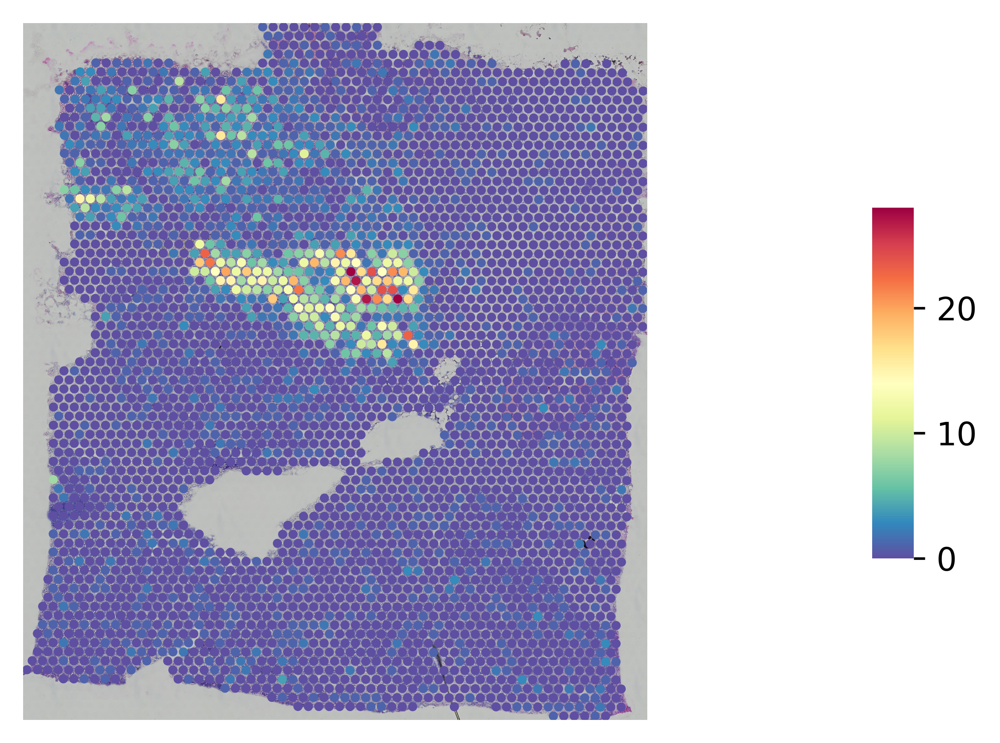

In [36]:
gene_plot(Sample1, genes=gene, spot_size=8)

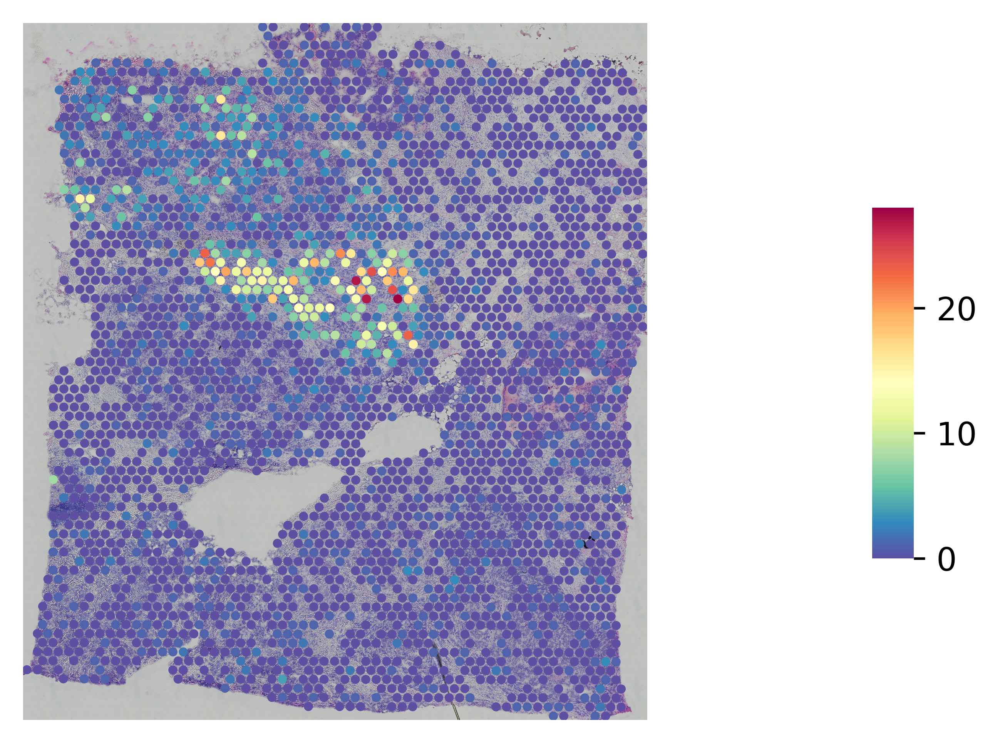

In [37]:
gene_plot(training_dataset, genes=gene, spot_size=8)

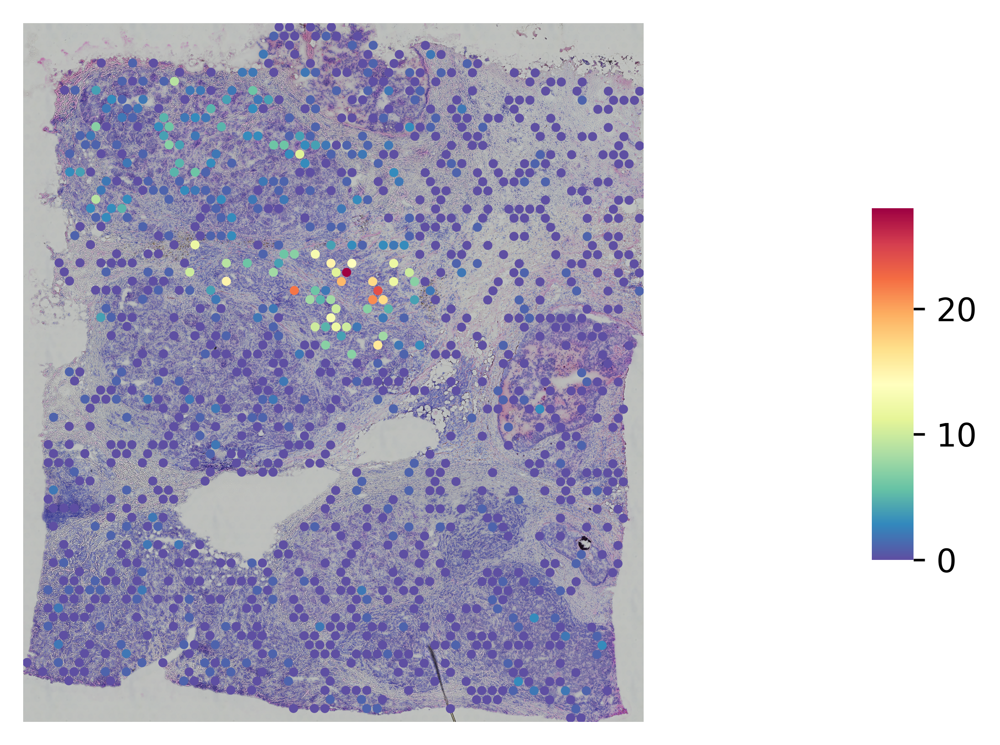

In [38]:
gene_plot(valid_dataset, genes=gene, spot_size=8)

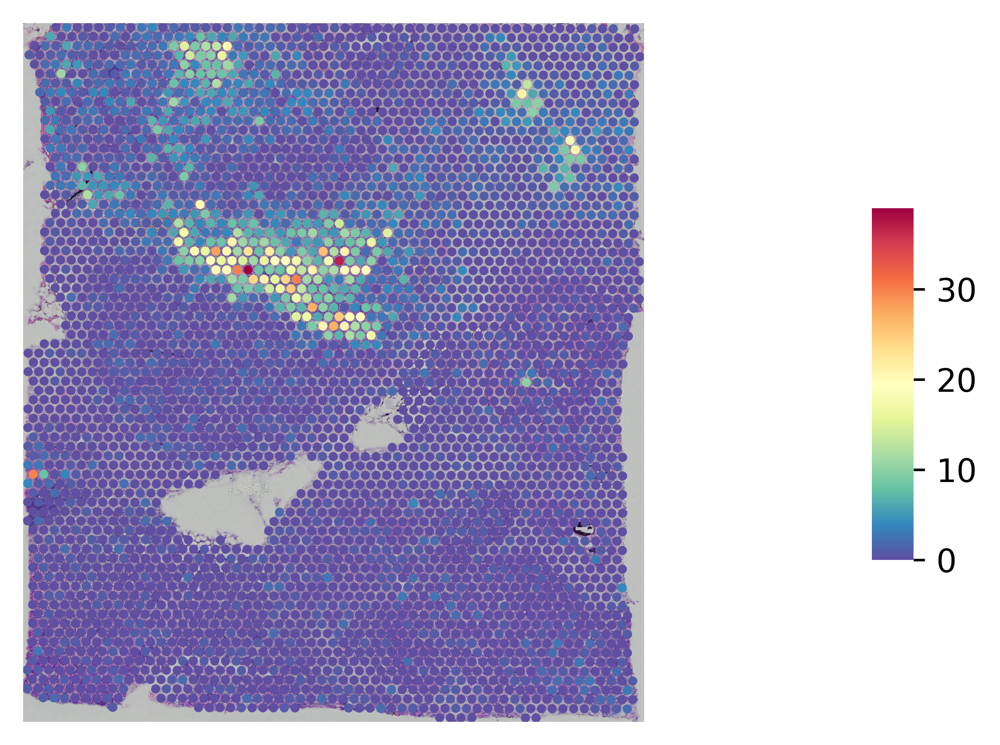

In [39]:
gene_plot(test_dataset, genes=gene, spot_size=8)

In [40]:
test_dataset_ = test_dataset[:,gene].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

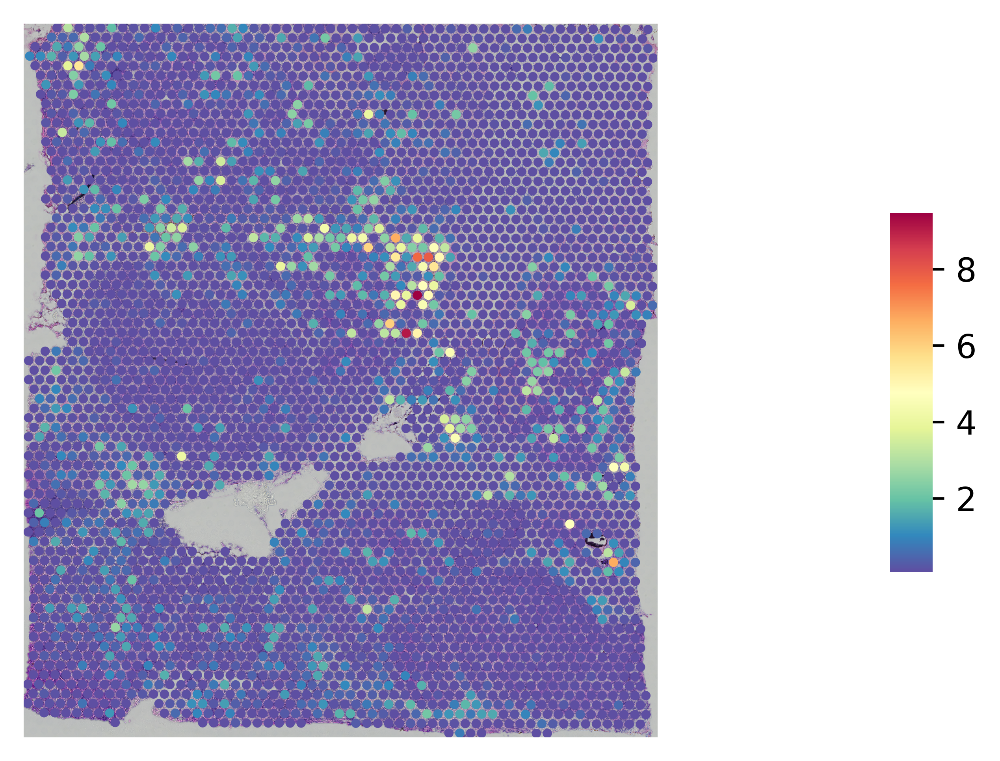

In [41]:
gene_plot(test_dataset_, genes=gene, spot_size=8)

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
from scipy import stats

r2 = stats.pearsonr(test_dataset[:,gene], 
                    test_dataset_[:,gene])[0] ** 2
sns.set_theme()
g = sns.lmplot(
    x=test_dataset[:,gene], y=test_dataset_[:,gene],
    height=5, legend=True
)
# g.set(ylim=(0, 360), xlim=(0,360))

g.set_axis_labels("true", "pred")
plt.annotate(r'$R^2:{0:.2f}$'.format(r2),
            (max(test_dataset[:,gene])*0.8, max(test_dataset_[:,gene])*0.8))